In [1]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dataset
import torchvision.transforms as transforms
import torchvision.utils as utils
from fasgan.generator import Generator
from fasgan.discriminator import Discriminator
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pdb

In [2]:
dataroot = "/media/codebuster/New Volume/personal/dcgan/cats"
workers = 2
batch_size = 48
image_size = 64
n_channels = 3
nz = 100
gen_dim = 64
dis_dim = 64
num_epochs = 50
lr = 0.001
beta1 = 0.5
beta2 = 0.999
ngpu = 1

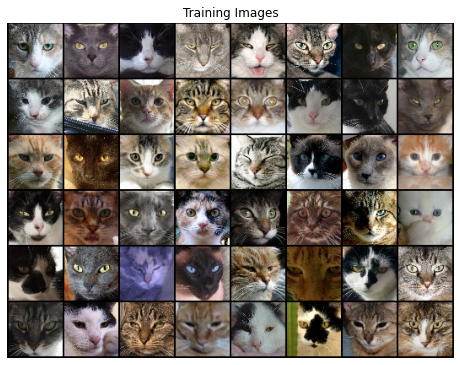

In [3]:
dataset = dataset.ImageFolder(root=dataroot,
                              transform=transforms.Compose([
                                  transforms.Resize(image_size),
                                  transforms.CenterCrop(image_size),
                                  transforms.ToTensor(),
                                  transforms.Normalize(mean=[0.5, 0.5, 0.5],std=[0.5, 0.5, 0.5]),
                              ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu>0) else 'cpu')
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(utils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1,2,0)))

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
netG = Generator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
    
netG.apply(weights_init)
print(netG)

Generator(
  (conv0): ConvTranspose2d(100, 1024, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (block1): Sequential(
    (0): Core(
      (layer0): Sequential(
        (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
      (layer1): Sequential(
        (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
    )
  )
  (inflate1): Sequential(
    (0): ConvTranspose2d(256, 512, kernel_size=(2, 2), stride=(2, 2), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stat

In [6]:
print("Total Trainable Parameters: {}".format(sum(p.numel() for p in netG.parameters() if p.requires_grad)))

Total Trainable Parameters: 14731584


In [7]:
netD = Discriminator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
netD.apply(weights_init)
print(netD)

Discriminator(
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (leaky_relu): LeakyReLU(negative_slope=0.2, inplace=True)
  (block1): Sequential(
    (0): Core(
      (layer0): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (layer1): Sequential(
        (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
      )
    )
  )
  (dilate1): Sequential(
    (0): Conv2d(256, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, in

In [8]:
print("Total Trainable Parameters: {}".format(sum(p.numel() for p in netD.parameters() if p.requires_grad)))

Total Trainable Parameters: 4640448


In [9]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(image_size, nz, 1, 1, device=device)
real_label = 1.
fake_label = 0.

optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))

In [10]:
img_list = list()
G_losses = list()
D_losses = list()
iters = 0

print("Starting Training Loop...")

for epoch in range(num_epochs):
    
    for i, data in enumerate(dataloader, 0):
        
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()
        
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        errD = errD_real + errD_fake
        optimizerD.step()
        
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(utils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1

Starting Training Loop...
[0/50][0/329]	Loss_D: 1.6785	Loss_G: 2.1691	D(x): 0.3566	D(G(z)): 0.3957 / 0.2307
[0/50][50/329]	Loss_D: 0.2385	Loss_G: 2.7106	D(x): 0.9336	D(G(z)): 0.1535 / 0.0694
[0/50][100/329]	Loss_D: 0.7029	Loss_G: 2.2333	D(x): 0.7700	D(G(z)): 0.3481 / 0.1142
[0/50][150/329]	Loss_D: 0.9451	Loss_G: 1.7489	D(x): 0.4888	D(G(z)): 0.1685 / 0.1935
[0/50][200/329]	Loss_D: 1.0638	Loss_G: 1.0178	D(x): 0.6955	D(G(z)): 0.4921 / 0.3837
[0/50][250/329]	Loss_D: 1.5663	Loss_G: 1.4007	D(x): 0.2682	D(G(z)): 0.0883 / 0.2547
[0/50][300/329]	Loss_D: 1.3880	Loss_G: 1.6868	D(x): 0.5057	D(G(z)): 0.4624 / 0.1987
[1/50][0/329]	Loss_D: 1.4652	Loss_G: 2.6442	D(x): 0.8374	D(G(z)): 0.6660 / 0.0838
[1/50][50/329]	Loss_D: 1.3453	Loss_G: 1.0513	D(x): 0.3844	D(G(z)): 0.2905 / 0.3660
[1/50][100/329]	Loss_D: 1.3125	Loss_G: 1.5199	D(x): 0.3958	D(G(z)): 0.2255 / 0.2394
[1/50][150/329]	Loss_D: 2.2845	Loss_G: 2.7879	D(x): 0.9810	D(G(z)): 0.8855 / 0.0873
[1/50][200/329]	Loss_D: 0.7400	Loss_G: 2.7232	D(x): 0.75

[14/50][0/329]	Loss_D: 1.4887	Loss_G: 2.3686	D(x): 0.7039	D(G(z)): 0.6052 / 0.1110
[14/50][50/329]	Loss_D: 1.7590	Loss_G: 1.3549	D(x): 0.2065	D(G(z)): 0.0645 / 0.2752
[14/50][100/329]	Loss_D: 0.9250	Loss_G: 4.4816	D(x): 0.8977	D(G(z)): 0.5507 / 0.0123
[14/50][150/329]	Loss_D: 0.8401	Loss_G: 4.6650	D(x): 0.9864	D(G(z)): 0.5256 / 0.0106
[14/50][200/329]	Loss_D: 0.6786	Loss_G: 3.8322	D(x): 0.7993	D(G(z)): 0.3491 / 0.0241
[14/50][250/329]	Loss_D: 0.7385	Loss_G: 2.7806	D(x): 0.5282	D(G(z)): 0.0606 / 0.0693
[14/50][300/329]	Loss_D: 1.9412	Loss_G: 1.7695	D(x): 0.1699	D(G(z)): 0.0062 / 0.1850
[15/50][0/329]	Loss_D: 2.8626	Loss_G: 10.7940	D(x): 0.9956	D(G(z)): 0.9245 / 0.0000
[15/50][50/329]	Loss_D: 0.4873	Loss_G: 2.6239	D(x): 0.6710	D(G(z)): 0.0748 / 0.0829
[15/50][100/329]	Loss_D: 0.9435	Loss_G: 6.4191	D(x): 0.9517	D(G(z)): 0.5822 / 0.0019
[15/50][150/329]	Loss_D: 0.8523	Loss_G: 3.8162	D(x): 0.4602	D(G(z)): 0.0349 / 0.0245
[15/50][200/329]	Loss_D: 0.3502	Loss_G: 4.3278	D(x): 0.9112	D(G(z)): 0

[27/50][300/329]	Loss_D: 1.8451	Loss_G: 7.9873	D(x): 0.9773	D(G(z)): 0.8220 / 0.0004
[28/50][0/329]	Loss_D: 2.0909	Loss_G: 6.3348	D(x): 0.9987	D(G(z)): 0.8575 / 0.0024
[28/50][50/329]	Loss_D: 0.1369	Loss_G: 3.5983	D(x): 0.9113	D(G(z)): 0.0374 / 0.0331
[28/50][100/329]	Loss_D: 0.6589	Loss_G: 7.9275	D(x): 0.9783	D(G(z)): 0.4473 / 0.0005
[28/50][150/329]	Loss_D: 0.3179	Loss_G: 4.2651	D(x): 0.9338	D(G(z)): 0.2080 / 0.0161
[28/50][200/329]	Loss_D: 1.0359	Loss_G: 7.1342	D(x): 0.9881	D(G(z)): 0.6199 / 0.0010
[28/50][250/329]	Loss_D: 0.1339	Loss_G: 5.4297	D(x): 0.9129	D(G(z)): 0.0402 / 0.0048
[28/50][300/329]	Loss_D: 0.6982	Loss_G: 1.6516	D(x): 0.5619	D(G(z)): 0.0788 / 0.2041
[29/50][0/329]	Loss_D: 1.9640	Loss_G: 7.4852	D(x): 0.9997	D(G(z)): 0.8389 / 0.0007
[29/50][50/329]	Loss_D: 0.8491	Loss_G: 6.4815	D(x): 0.9878	D(G(z)): 0.5360 / 0.0023
[29/50][100/329]	Loss_D: 1.7097	Loss_G: 6.8766	D(x): 0.6939	D(G(z)): 0.7182 / 0.0013
[29/50][150/329]	Loss_D: 0.1609	Loss_G: 4.3888	D(x): 0.9532	D(G(z)): 0.

[41/50][250/329]	Loss_D: 0.1338	Loss_G: 6.4877	D(x): 0.9822	D(G(z)): 0.1080 / 0.0018
[41/50][300/329]	Loss_D: 0.6360	Loss_G: 4.4437	D(x): 0.9900	D(G(z)): 0.4512 / 0.0142
[42/50][0/329]	Loss_D: 2.7278	Loss_G: 7.3252	D(x): 0.9989	D(G(z)): 0.9190 / 0.0013
[42/50][50/329]	Loss_D: 0.3780	Loss_G: 4.7884	D(x): 0.9541	D(G(z)): 0.2687 / 0.0098
[42/50][100/329]	Loss_D: 0.6919	Loss_G: 8.1826	D(x): 0.9586	D(G(z)): 0.4471 / 0.0003
[42/50][150/329]	Loss_D: 1.2337	Loss_G: 6.3806	D(x): 0.3220	D(G(z)): 0.0021 / 0.0023
[42/50][200/329]	Loss_D: 0.1323	Loss_G: 4.9372	D(x): 0.8855	D(G(z)): 0.0060 / 0.0084
[42/50][250/329]	Loss_D: 1.3413	Loss_G: 7.6738	D(x): 0.2997	D(G(z)): 0.0006 / 0.0007
[42/50][300/329]	Loss_D: 0.4561	Loss_G: 3.9120	D(x): 0.6594	D(G(z)): 0.0102 / 0.0220
[43/50][0/329]	Loss_D: 0.8326	Loss_G: 0.4514	D(x): 0.4682	D(G(z)): 0.0036 / 0.6668
[43/50][50/329]	Loss_D: 1.0401	Loss_G: 2.3477	D(x): 0.3929	D(G(z)): 0.0083 / 0.1110
[43/50][100/329]	Loss_D: 0.5643	Loss_G: 9.9095	D(x): 0.5840	D(G(z)): 0.

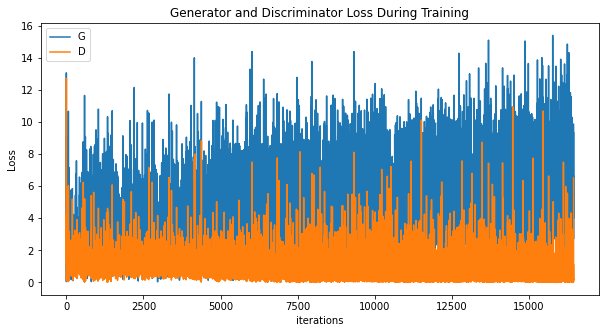

In [13]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

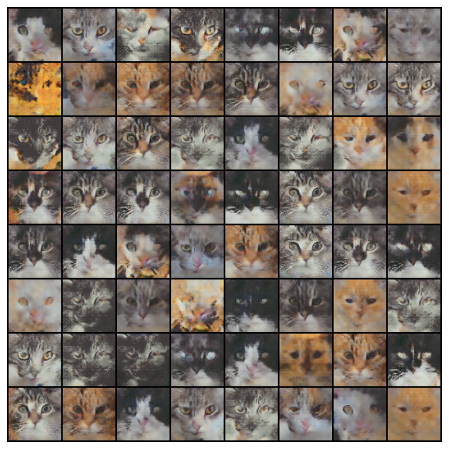

In [14]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

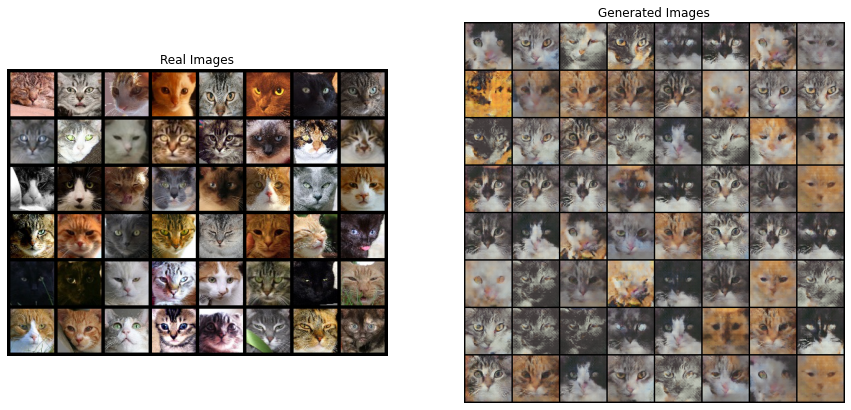

In [15]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Generated Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()